In [3]:

from scipy.interpolate import griddata

import matplotlib.pyplot  as plt

from matplotlib import cm
from collections import OrderedDict
from colorspacious import cspace_converter
cmaps=OrderedDict()
cmaps['Perceptually Uniform Sequential'] = [
            'viridis', 'plasma', 'inferno', 'magma', 'cividis']

cmaps['Sequential'] = [
            'Greys', 'Purples', 'Blues', 'Greens', 'Oranges', 'Reds',
            'YlOrBr', 'YlOrRd', 'OrRd', 'PuRd', 'RdPu', 'BuPu',
            'GnBu', 'PuBu', 'YlGnBu', 'PuBuGn', 'BuGn', 'YlGn']
cmaps['Sequential (2)'] = [
            'binary', 'gist_yarg', 'gist_gray', 'gray', 'bone', 'pink',
    
            'spring', 'summer', 'autumn', 'winter', 'cool', 'Wistia',
            'hot', 'afmhot', 'gist_heat', 'copper']

cmaps['Diverging'] = [
            'PiYG', 'PRGn', 'BrBG', 'PuOr', 'RdGy', 'RdBu',
            'RdYlBu', 'RdYlGn', 'Spectral', 'coolwarm', 'bwr', 'seismic']

cmaps['Miscellaneous'] = [
            'flag', 'prism', 'ocean', 'gist_earth', 'terrain', 'gist_stern',
            'gnuplot', 'gnuplot2', 'CMRmap', 'cubehelix', 'brg',
            'gist_rainbow', 'rainbow', 'jet', 'turbo', 'nipy_spectral',
            'gist_ncar']

###Les données 

import tensorflow as tf
import numpy as np
import scipy.io
import time
import sys
import os
from tensorflow import keras







#path_data = '/media/delcey1/Elements/these/GRAVITY_CURRENTS/DATA/DATA_12_04/run_200_450_pas_4.mat'
path_data = '/media/delcey1/Elements/these/GRAVITY_CURRENTS/DATA/DATA_20_04/data_pas_1_23_04.mat'
#path_data = '/media/delcey1/Elements/these/GRAVITY_CURRENTS/DATA/DATA_20_04/run_200_450_piv0.mat'
def data_regression_rho(path_data,t1,t2,proportion):
    data = scipy.io.loadmat(path_data)
    t_star = data['t'].reshape([-1,1])[t1:t2]# T x 1
    x_star = data['x'][:,t1:t2] # N x 1
    y_star = data['y'][:,t1:t2] # N x 1

    
    T = t_star.shape[0]
    print(T)
    N = x_star.shape[0]
    print(N)
    Rho_star = data['Densite'][:,t1:t2]
    T_star = np.tile(t_star, (1,N)).T
    print(T_star.shape)
    X_star = x_star 
    Y_star = y_star 
    T_data = T # int(sys.argv[1])
    N_data = N # int(sys.argv[2])
    ind_t = np.random.randint(T_data,size = T_data)
    ind_x = np.random.randint(N_data, size = int(N_data*proportion))
    print(ind_t.shape)
    t_data = T_star[ind_x, :][:,ind_t].flatten().reshape(-1,1)
    x_data = X_star[ind_x, :][:,ind_t].flatten().reshape(-1,1)
    y_data = Y_star[ind_x, :][:,ind_t].flatten().reshape(-1,1)
    rho_data = Rho_star[ind_x, :][:,ind_t].flatten().reshape(-1,1)
    
    return t_data,x_data,y_data,rho_data

t_data, x_data, y_data, rho_data = data_regression_rho(path_data,0,500,1.0)
inp_grad=np.concatenate([x_data,y_data,t_data],1)
inp_train = inp_grad

data_X = [inp_grad,inp_train]
data_Y = [rho_data]

300
15353
(15353, 300)
(300,)


In [2]:
data_Y[0].shape


(3546543, 1)

In [2]:
import tensorflow as tf
import tensorflow_addons as tfa

In [4]:

class HFM_keras(tf.keras.Model):
    
    def __init__(self,num_layer,num_units,num_units_eqns,num_layer_eqns,mod_path=None,mod_eqns_path=None,lr_start=1e-3):
 

        
        super(HFM_keras, self).__init__()
        self.alpha = 1
        visc=1e-3 
        eta = 1e-9
        g=9.81
        rho_0=999.4
        ##Les constantes
        self.visc = visc
        self.eta = eta
        self.g = g 
        self.rho_0 = rho_0
        self.grad_input = None

        #Le réseau
        self.lr = lr_start
        self.num_units = num_units
        self.num_layer = num_layer
        self.layers_ = []
        self.layers_eqns = []
        
        self.train_loss = []
        
        
        if mod_path is None:
            for i in range(num_layer):
                self.layers_.append(keras.layers.BatchNormalization())
                hidden = keras.layers.Dense(num_units,activation = 'elu',dtype = tf.float32)
                self.layers_.append(hidden)
            self.layers_.append(keras.layers.Dense(1))
            self.model_ = keras.models.Sequential(self.layers_)
        else:
            self.model_ = keras.models.load_model(mod_path)
            
            
        if mod_eqns_path is None:
            for i in range(num_layer_eqns):
                hidden_eqns = keras.layers.Dense(num_units_eqns,activation = 'swish',dtype = tf.float32)
                self.layers_eqns.append(hidden_eqns)
            self.layers_eqns.append(keras.layers.Dense(3))
            self.model_eqns = keras.models.Sequential(self.layers_eqns)
        else:
            self.model_eqns = keras.models.load_model(mod_eqns_path)
        
        
        

        
    
    
    

                
    def call(self, inputs):
        return self.model_(inputs)
   
        

    
    def compute_duvp_eq(self,inputs):
        visc = self.visc
        g = self.g
        eta = self.eta
        rho_0 = self.rho_0
        x = tf.convert_to_tensor(inputs[:,0:1], dtype=tf.float32)
        y = tf.convert_to_tensor(inputs[:,1:2], dtype=tf.float32)
        t = tf.convert_to_tensor(inputs[:,2:], dtype=tf.float32)
        with tf.GradientTape(persistent =True) as t2:
            t2.watch(x)
            t2.watch(y)
            t2.watch(t)
            with tf.GradientTape(persistent = True) as t1 :
                t1.watch(x)
                t1.watch(y)
                t1.watch(t)
                X = tf.stack([x[:,0],y[:,0],t[:,0]],axis = 1 )
                rho = self.model_(X,training = False)
                rho = tf.reshape(rho,(-1,1))
                Y = self.model_eqns(X,training = True)
                u,v,p = tf.reshape(Y[:,0],(-1,1)),tf.reshape(Y[:,1],(-1,1)),\
                tf.reshape(Y[:,2],(-1,1))
                ##e5
                Ec = 0.5 * rho_0 *(tf.square(u) + tf.square(v))
                Ec = tf.reshape(Ec,(-1,1))
                Ec_x = u* (Ec+p)
                Ec_x = tf.reshape(Ec_x,(-1,1))
                Ec_y = v*(Ec+p)
                Ec_y = tf.reshape(Ec_y,(-1,1))
                
            
                
                
                ##Les dérivées premières
            rho_x = t1.gradient(rho, x)
            rho_y = t1.gradient(rho, y)
            rho_t = t1.gradient(rho, t)
            Ec_t = t1.gradient(Ec, t)
            
            
            divEcp_x = t1.gradient(Ec_x, x)
            divEcp_y = t1.gradient(Ec_y, y)
            divEcp = divEcp_x+divEcp_y
            u_x = t1.gradient(u, x)
            u_y = t1.gradient(u, y)
            u_t = t1.gradient(u, t)
            v_x= t1.gradient(v, x)
            v_y= t1.gradient(v, y)
            v_t= t1.gradient(v, t)
            p_x = t1.gradient(p, x)
            p_y = t1.gradient(p, y)
            p_t = t1.gradient(p, t)
            
         
            
        ###les dérivées secondes
        rho_xx=t2.gradient(rho_x, x)
        rho_yy=t2.gradient(rho_y, y)
        u_xx=t2.gradient(u_x, x)
        u_yy=t2.gradient(u_y, y)
        v_xx=t2.gradient(v_x, x)
        v_yy=t2.gradient(v_y, y)
        diffvisc = u * (u_xx+u_yy) + v * (v_xx+v_yy)
        
        e1 = (rho_0)*(u*u_x+v*u_y+u_t)+p_x-visc*(u_xx+u_yy)
        e2 = (rho_0)*(u*v_x+v*v_y+v_t)+p_y-visc*(v_xx+v_yy)+g*rho
        e3 = u_x + v_y
        e4 = u*rho_x+v*rho_y+rho_t-eta*(rho_xx+rho_yy)
        e5 = Ec_t + divEcp + rho * g * v - visc * diffvisc

        
        
    
    
        
  
   
       
         
        return e1,e2,e3,e4,e5
    





    ##Loss
    def grad_loss(self,inp_grad,inp_train):

        e1,e2,e3,e4,e5 = self.compute_duvp_eq(inp_grad)
        error_e1 = tf.reduce_mean(tf.square(e1))
        error_e2 = tf.reduce_mean(tf.square(e2))
        error_e3 = tf.reduce_mean(tf.square(e3))
        error_e4 = tf.reduce_mean(tf.square(e4))
        error_e5 = tf.reduce_mean(tf.square(e5))

        return [error_e1, error_e2, error_e3, error_e4, error_e5]
    
    

                              
                              
                              
                    

        

    def predict(self, inputs):
        inputs = tf.convert_to_tensor(inputs,dtype = tf.float32)
        pred = self.model(inputs)
        e1, e2, e3,e4 , e5  = self.NavierStokesEquations(inputs)
        return  pred[:,0].numpy(),e1,e2,e3,e4,e5
    
    def random_batch(self,X,y,batch_size = 32):
        idx = np.random.randint(X[0].shape[0],size = batch_size)
        return [tf.convert_to_tensor(inp[idx,:],dtype = tf.float32) for inp in X],\
    [tf.convert_to_tensor(y_[idx,:],dtype = tf.float32) for y_ in y]
    
    
    def print_status_bar(self,iteration, total, loss, metrics=None):
        metrics = " - ".join(["{}: {:.4f}".format(m.name,m.result()) for m in [loss] + (metrics or [])])
        
        end = "" if iteration <total else "\n" 
        
        print("\r{}/{} - ".format(iteration, total) + metrics, end=end ) 
    
        
        
       
    def train(self,X,y,lr_end,epoch_,loss_fn,n_epochs,\
              mean_loss = keras.metrics.MeanSquaredError(),metrics = [keras.metrics.MeanSquaredError()],\
              batch_size = 32):
        

        n_steps = X[0].shape[0]// batch_size +1
        lr_start = self.lr
        decay = (lr_end/lr_start)**(1/epoch_)
        

        for epoch in range(1,n_epochs +1 ):
            optimizer = keras.optimizers.Adam(lr = self.lr)
            progbar = keras.utils.Progbar(batch_size * n_steps,width=10, verbose=1, interval=0.5)
            print("Epoch {}/{}".format(epoch + 1, n_epochs))
            sys.stdout.flush()
            for step in range(1,n_steps+1):
                X_batch,y_batch =self.random_batch(X,y,batch_size=batch_size)
                inp_grad_batch = X_batch[0]
                inp_train_batch = X_batch[1]    
                rho_obs_batch = y_batch[0]
                
                names = ['e1','e2','e3','e4','e5']
                values = []
                with tf.GradientTape(persistent = True) as tape:
                    if self.alpha == 0:
                        rho = self.model_(inp_train_batch,training = True)
                        loss = tf.reduce_mean(tf.square(rho-rho_obs_batch))
                        values = [('loss',loss)]
                    else:
                        #rho = self.model_(inp_train_batch)
                        #loss_rho = tf.reduce_mean(tf.square(rho-rho_obs_batch))
                        #values.append(('loss_rho',loss_rho))
                        list_losses = self.grad_loss(inp_grad_batch,inp_train_batch)
                        loss_eqns = 0 
                        for ind,loss_ in enumerate(list_losses):
                            loss_eqns+= loss_
                            values.append((names[ind],loss_))
                        self.train_loss.append(loss_eqns.numpy())
                        values.append(('loss eqns', loss_eqns))
                        values.append(('lr',self.lr))
                #gradients_rho = tape.gradient(loss_rho,self.model_.trainable_variables)
                for i in range(2):
                    gradients_eqns = tape.gradient(loss_eqns,self.model_eqns.trainable_variables)
                    optimizer.apply_gradients(zip(gradients_eqns,self.model_eqns.trainable_variables))
                #optimizer.apply_gradients(zip(gradients_rho,self.model_.trainable_variables))
                progbar.add(batch_size, values=values) 
            if epoch%2==0:
                self.lr = max(self.lr*decay,1e-6)
            
            

        
   
    
    
    
                
    

            
                
    def predict_step(self,X_test,batch_size):
        n = X_test.shape[0]
        n1 = n//batch_size
        rho_pred = np.zeros((n,1))
        u_pred,v_pred,p_pred =  np.zeros((n,1)), np.zeros((n,1)), np.zeros((n,1))
        for ind in range(n1):
            pred = self.model_eqns(X_test[ind*batch_size:(ind+1)*batch_size,:],training = False)
            pred_2 =  self.model_(X_test[ind*batch_size:(ind+1)*batch_size,:],training = False)
            rho_pred_batch=pred_2[:,0].numpy().reshape(-1,1)
            u_pred_batch=pred[:,0].numpy().reshape(-1,1)
            v_pred_batch=pred[:,1].numpy().reshape(-1,1)
            p_pred_batch=pred[:,2].numpy().reshape(-1,1)
            

            rho_pred[ind*batch_size:(ind+1)*batch_size]=rho_pred_batch
            u_pred[ind*batch_size:(ind+1)*batch_size]=u_pred_batch
            v_pred[ind*batch_size:(ind+1)*batch_size]=v_pred_batch
            p_pred[ind*batch_size:(ind+1)*batch_size]=p_pred_batch
        f_pred = self.model_eqns(X_test[(n1-1)*batch_size:,:])
        f_pred_2 = self.model_(X_test[(n1-1)*batch_size:,:])

        rho_f_pred = f_pred_2[:,0].numpy().reshape(-1,1)
        u_f_pred = f_pred[:,0].numpy().reshape(-1,1)
        v_f_pred = f_pred[:,1].numpy().reshape(-1,1)
        p_f_pred = f_pred[:,2].numpy().reshape(-1,1)
        rho_pred[(n1-1)*batch_size:,:]=rho_f_pred
        u_pred[(n1-1)*batch_size:,:]=u_f_pred
        v_pred[(n1-1)*batch_size:,:]=v_f_pred
        p_pred[(n1-1)*batch_size:,:]=p_f_pred
        
        return [rho_pred,u_pred,v_pred,p_pred]
            
                
 

In [8]:
flow_prop = { 'visc':4e-3, 'eta': 1e-9 , 'g':9.81,'rho_0':999.4}

In [ ]:
#mod_eqns_path = 'model_eqns_02.hf5'

In [2]:
tf.keras.backend.clear_session()
mod = HFM_keras(num_layer= 2, num_units =200,num_layer_eqns = 6,num_units_eqns = 300,mod_path = 'model_rho_newexp_29_04.hf5',mod_eqns_path='model_eqns_newexp_29_04.hf5',lr_start = 4e-5)

NameError: name 'HFM_keras' is not defined

In [5]:
mod.train(data_X,data_Y,lr_end = 1e-6,epoch_ = 25,loss_fn = keras.losses.MeanSquaredError(),n_epochs = 500,batch_size =2048*2
          )

Epoch 2/500
4608000/4608000 [==========] - 306s 66us/step - e1: 8.4246e-04 - e2: 0.0039 - e3: 1.8214e-04 - e4: 2.7123e-05 - e5: 2.9316e-07 - loss eqns: 0.0049 - lr: 4.0000e-05
Epoch 3/500
4608000/4608000 [==========] - 306s 66us/step - e1: 5.9804e-04 - e2: 0.0036 - e3: 2.1624e-04 - e4: 2.2962e-05 - e5: 6.4149e-08 - loss eqns: 0.0044 - lr: 4.0000e-05
Epoch 4/500
4608000/4608000 [==========] - 306s 66us/step - e1: 4.7918e-04 - e2: 0.0031 - e3: 1.8639e-04 - e4: 2.2899e-05 - e5: 4.9152e-08 - loss eqns: 0.0038 - lr: 3.4513e-05
Epoch 5/500
4608000/4608000 [==========] - 307s 67us/step - e1: 4.6454e-04 - e2: 0.0029 - e3: 1.8352e-04 - e4: 2.1542e-05 - e5: 4.7238e-08 - loss eqns: 0.0036 - lr: 3.4513e-05
Epoch 6/500
4608000/4608000 [==========] - 310s 67us/step - e1: 3.5887e-04 - e2: 0.0025 - e3: 1.5684e-04 - e4: 2.2460e-05 - e5: 3.9896e-08 - loss eqns: 0.0031 - lr: 2.9778e-05
Epoch 7/500
4608000/4608000 [==========] - 308s 67us/step - e1: 3.5707e-04 - e2: 0.0024 - e3: 1.5347e-04 - e4: 2.1693e-0

KeyboardInterrupt: 

In [7]:
path_save = '/media/delcey1/Elements/these/Re 2000'
path_save2 = '/home/delcey1/Documents/Re 2000/'
path_data = '/media/delcey1/Elements/these/GRAVITY_CURRENTS/DATA/DATA_20_04/data_pred_pas_4_23_04.mat'
#path_data = '/media/delcey1/Elements/these/Re 2000/datafiltre_piv_01.mat'
#path_data = '/media/delcey1/Elements/these/GRAVITY_CURRENTS/DATA/DATA_20_04/data_pred_pas_4_23_04.mat'
l = os.listdir(path_save)

data = scipy.io.loadmat(path_data)

t_star = data['t'].reshape([-1,1])[0:300] # T x 1
x_star = data['x'].reshape([-1,1]) # N x 1
y_star = data['y'].reshape([-1,1]) # N x 1



T = t_star.shape[0]
N = x_star.shape[0]
    
    # Rearrange Data 
T_star = np.tile(t_star, (1,N)).T # N x T
X_star = np.tile(x_star, (1,T)) # N x T
Y_star = np.tile(y_star, (1,T)) # N x T




Rho_star = data['Densite'][:,0:300]#N x T





In [8]:
t_0 =-1

t_test = T_star[:,t_0].flatten().reshape(-1,1)
x_test = X_star[:,t_0].flatten().reshape(-1,1)
y_test = Y_star[:,t_0].flatten().reshape(-1,1)
X= np.concatenate([x_test,y_test,t_test],1)
pred = mod.predict_step(X,5000)
[rho_pred,u_pred,v_pred,p_pred]=pred

py,px = data['pixel_xy'][0,0],data['pixel_xy'][0,1]


In [6]:
mod.model_eqns.save('model_eqns_newexp_29_04.hf5')

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: model_eqns_newexp_29_04.hf5/assets


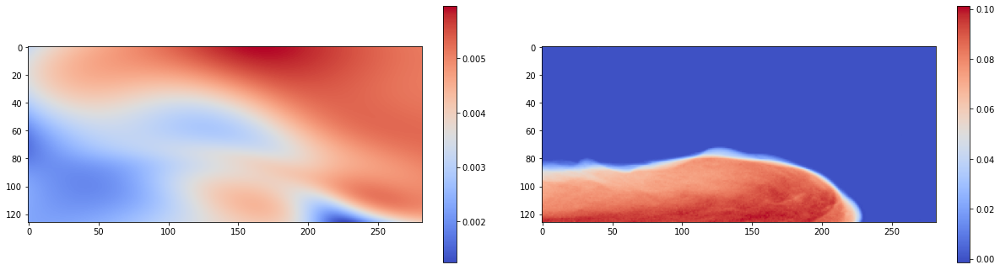

In [12]:
fig, (ax,ax1) =plt.subplots(ncols = 2, figsize = (20,12))
pos = ax.imshow(u_pred.reshape(py,px),cmap = cmaps['Diverging'][9])
pos1 = ax1.imshow(Rho_star[:,t_0].reshape(py,px),cmap = cmaps['Diverging'][9])
fig.colorbar(pos,ax=ax,fraction = 0.03)
fig.colorbar(pos1,ax=ax1,fraction = 0.03)
plt.show()



In [30]:
list_rho_pred = []
list_u_pred =  []
list_v_pred = []
list_p_pred =  []

for i in range(T_star.shape[1]):
    t_test = T_star[:,i].flatten().reshape(-1,1)
    x_test = X_star[:,i].flatten().reshape(-1,1)
    y_test = Y_star[:,i].flatten().reshape(-1,1)
    X= np.concatenate([x_test,y_test,t_test],1)
    pred = mod.predict_step(X,5000)
    [rho_pred,u_pred,v_pred,p_pred]=pred
    list_rho_pred.append(rho_pred)
    list_u_pred.append(u_pred)
    list_v_pred.append(v_pred)
    list_p_pred.append(p_pred)


py,px = data['pixel_xy'][0,0],data['pixel_xy'][0,1]


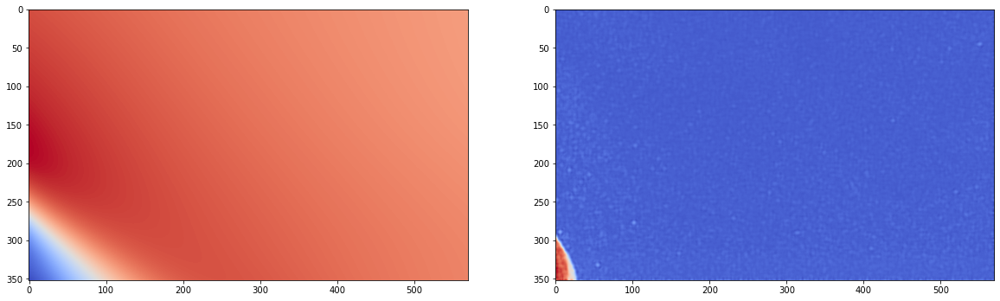

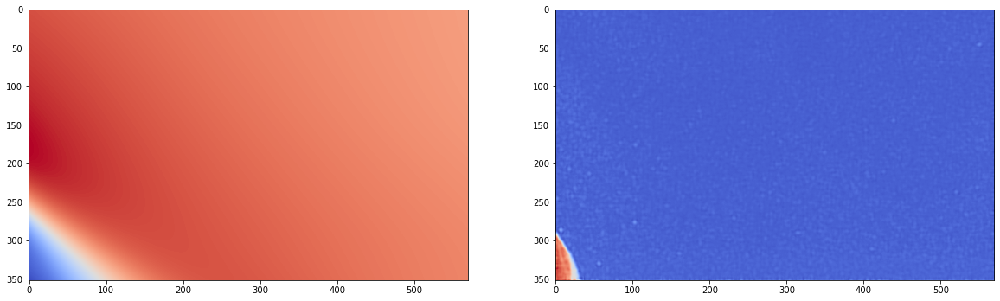

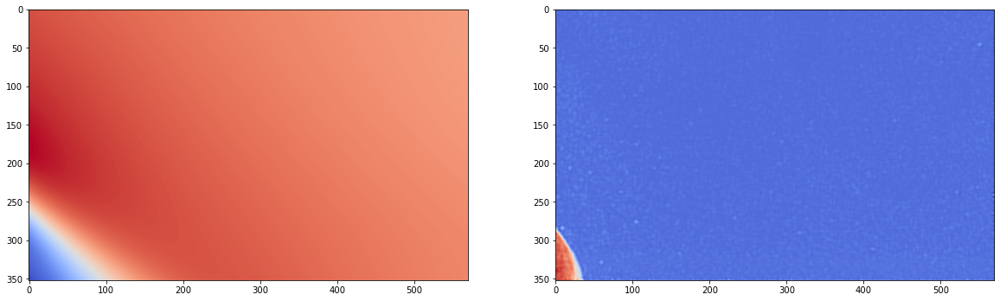

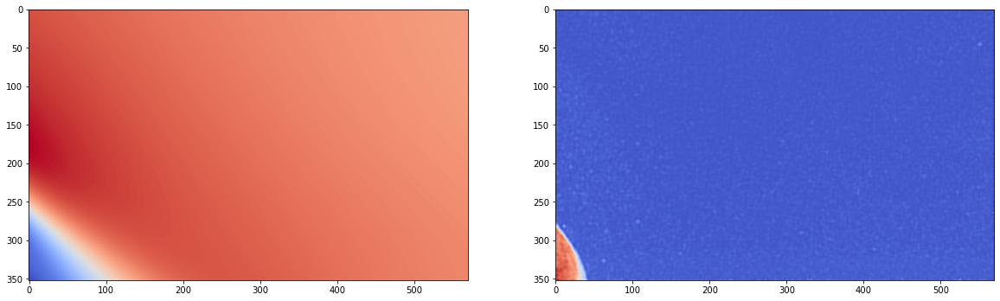

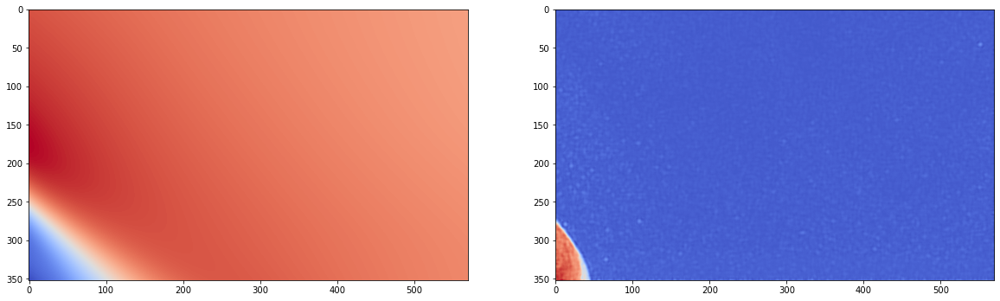

...

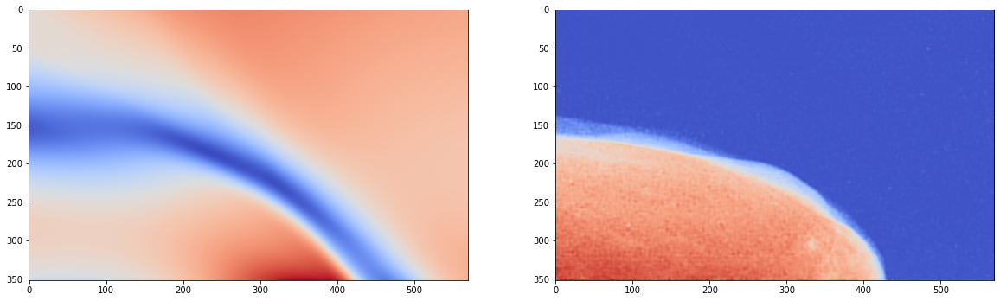

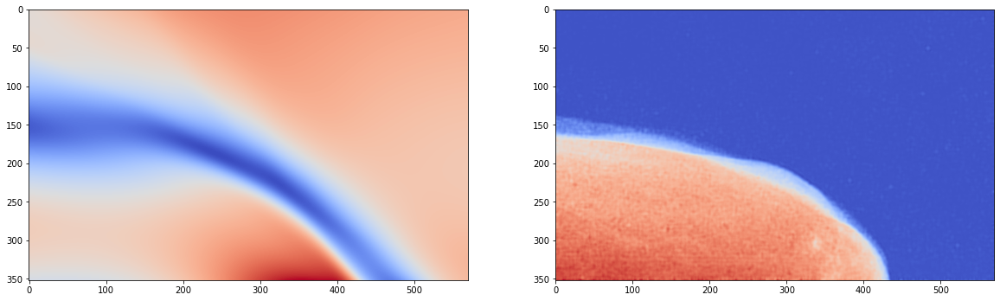

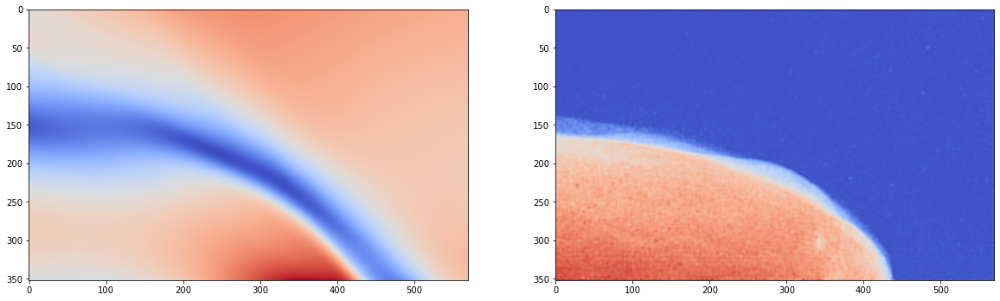

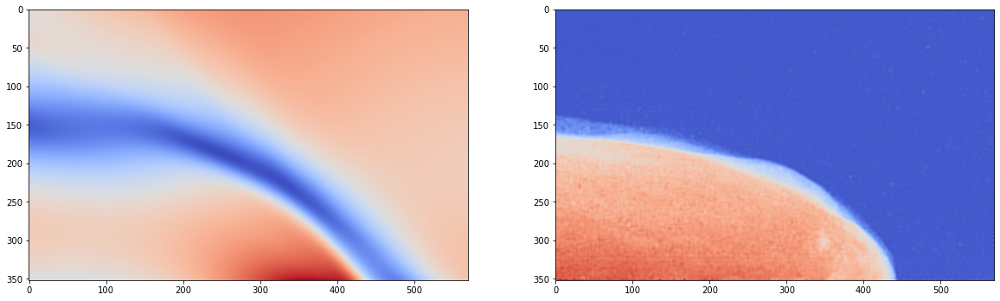

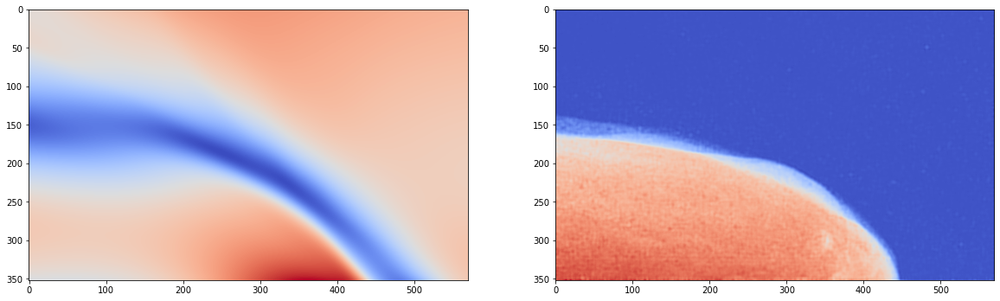

In [31]:
for i in range(0,T_star.shape[1],2):
    fig, (ax,ax1) =plt.subplots(ncols = 2, figsize = (20,12))
    ax.imshow(list_u_pred[i].reshape(py,px),cmap = cmaps['Diverging'][9])
    ax1.imshow(Rho_star[:,i].reshape(py,px),cmap = cmaps['Diverging'][9])
    plt.show()


In [12]:
def save_prediction(mod,path_data,path_save,name):
    data = scipy.io.loadmat(path_data)
    t_star = data['t'].reshape([-1,1])[0:231] # T x 1
    x_star = data['x'].reshape([-1,1]) # N x 1
    y_star = data['y'].reshape([-1,1]) # N x 1
    x_max = np.max(x_star)
    y_max = np.max(y_star)
    T = t_star.shape[0]
    N = x_star.shape[0]
    # Rearrange Data 
    T_star = np.tile(t_star, (1,N)).T # N x T
    X_star = np.tile(x_star, (1,T)) # N x T
    Y_star = np.tile(y_star, (1,T)) # N x T
    Rho_star = data['Densite'][:,0:231]#N x T
    list_rho_pred = []
    list_u_pred =  []
    list_v_pred = []
    list_p_pred =  []

    for i in range(T_star.shape[1]):
        print('t_step = %s'%(i))
        t_test = T_star[:,i].flatten().reshape(-1,1)
        x_test = X_star[:,i].flatten().reshape(-1,1)
        y_test = Y_star[:,i].flatten().reshape(-1,1)
        X= np.concatenate([x_test,y_test,t_test],1)
        pred = mod.predict_step(X,5000)
        [rho_pred,u_pred,v_pred,p_pred]=pred
        list_rho_pred.append(rho_pred)
        list_u_pred.append(u_pred)
        list_v_pred.append(v_pred)
        list_p_pred.append(p_pred)
    py,px = data['pixel_xy'][0,0],data['pixel_xy'][0,1]
    scipy.io.savemat(os.path.join(path_save,name), {'X':(x_max,y_max),'rho_pred':list_rho_pred,'u_pred':list_u_pred,'v_pred':list_v_pred,'p_pred':list_p_pred,'pixel_xy':(py,px)})
    return 'Done'

path_data = '/media/delcey1/Elements/these/Re 2000/datafiltre_piv_01.mat'
path_save = '/media/delcey1/Elements/these/Gr_keras/'
save_prediction(mod,path_data,path_save,'piv_00.mat')

t_step = 0
t_step = 1
t_step = 2
t_step = 3
t_step = 4
t_step = 5
t_step = 6
t_step = 7
t_step = 8
t_step = 9
t_step = 10
t_step = 11
t_step = 12
t_step = 13
t_step = 14
t_step = 15
t_step = 16
t_step = 17
t_step = 18
t_step = 19
t_step = 20
t_step = 21
t_step = 22
t_step = 23
t_step = 24
t_step = 25
t_step = 26
t_step = 27
t_step = 28
t_step = 29
t_step = 30
t_step = 31
t_step = 32
t_step = 33
t_step = 34
t_step = 35
t_step = 36
t_step = 37
t_step = 38
t_step = 39
t_step = 40
t_step = 41
t_step = 42
t_step = 43
t_step = 44
t_step = 45
t_step = 46
t_step = 47
t_step = 48
t_step = 49
t_step = 50
t_step = 51
t_step = 52
t_step = 53
t_step = 54
t_step = 55
t_step = 56
t_step = 57
t_step = 58
t_step = 59
t_step = 60
t_step = 61
t_step = 62
t_step = 63
t_step = 64
t_step = 65
t_step = 66
t_step = 67
t_step = 68
t_step = 69
t_step = 70
t_step = 71
t_step = 72
t_step = 73
t_step = 74
t_step = 75
t_step = 76
t_step = 77
t_step = 78
t_step = 79
t_step = 80
t_step = 81
t_step = 82
t_step = 83
t_

'Done'